/var/folders/kd/f52lk2hx29q0b1pmk69q0gjm0000gn/T/ipykernel_53381/2118585125.py:64: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()


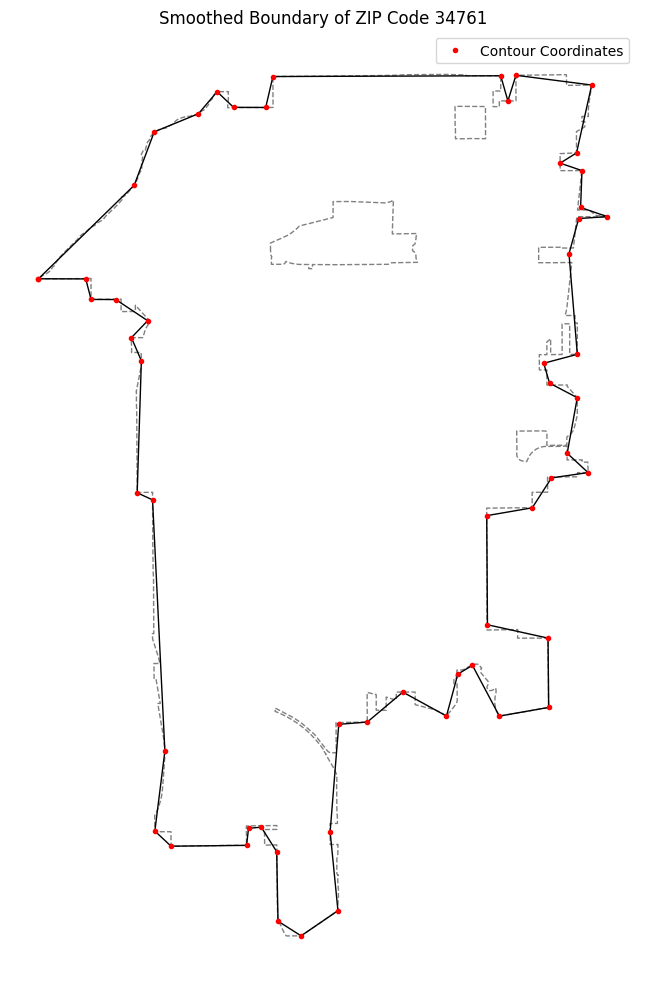

polygon = [
    (-81.57425, 28.597479),
    (-81.561226, 28.608653),
    (-81.558497, 28.615034),
    (-81.552477, 28.617207),
    (-81.549938, 28.619836),
    (-81.547705, 28.617971),
    (-81.543328, 28.617951),
    (-81.542347, 28.62165),
    (-81.511344, 28.621743),
    (-81.510365, 28.618737),
    (-81.509268, 28.6218),
    (-81.498959, 28.620635),
    (-81.501023, 28.612522),
    (-81.503252, 28.611297),
    (-81.500282, 28.610407),
    (-81.500469, 28.606),
    (-81.496832, 28.604902),
    (-81.500726, 28.604678),
    (-81.502049, 28.600476),
    (-81.500917, 28.588448),
    (-81.505494, 28.587378),
    (-81.504689, 28.584999),
    (-81.500922, 28.583263),
    (-81.502294, 28.576625),
    (-81.499452, 28.574312),
    (-81.504435, 28.573675),
    (-81.507053, 28.570101),
    (-81.513246, 28.569164),
    (-81.513145, 28.556125),
    (-81.504901, 28.554528),
    (-81.504816, 28.546244),
    (-81.511521, 28.545208),
    (-81.515193, 28.551275),
    (-81.51718, 28.550222),
    (-81.5

In [9]:
import geopandas as gpd
import matplotlib.pyplot as plt
import requests
import io
import zipfile
from shapely.geometry import Polygon, MultiPolygon

def get_zipcode_boundary(zipcode):
    # URL for the 2022 ZCTA shapefile (you can update the year as needed)
    url = "https://www2.census.gov/geo/tiger/TIGER2022/ZCTA520/tl_2022_us_zcta520.zip"
    
    # Download the zipfile
    r = requests.get(url)
    z = zipfile.ZipFile(io.BytesIO(r.content))
    
    # Extract the shapefile
    z.extractall("temp_zcta")
    
    # Read the shapefile
    gdf = gpd.read_file("temp_zcta/tl_2022_us_zcta520.shp")
    
    # Filter for the specific ZIP code
    zip_gdf = gdf[gdf['ZCTA5CE20'] == zipcode]
    
    if zip_gdf.empty:
        print(f"No data found for ZIP code {zipcode}")
        return None
    
    return zip_gdf

def get_smoothed_outermost_contour(gdf):
    # Take the geometry of the ZIP code area and get the largest polygon if it's a MultiPolygon
    geometry = gdf.geometry.unary_union  # Merge into a single shape if multiple features are present
    
    if isinstance(geometry, MultiPolygon):
        largest_polygon = max(geometry, key=lambda p: p.area)
    else:
        largest_polygon = geometry

    # Apply buffer to smooth out sharp edges, then return to original size
    smoothed_contour = largest_polygon.buffer(0.001).buffer(-0.001).simplify(0.001)
    
    # Remove interior rings (holes) and get the exterior boundary coordinates
    outer_contour = Polygon(smoothed_contour.exterior)
    outer_contour_coords = [(round(coord[0], 6), round(coord[1], 6)) for coord in outer_contour.exterior.coords]
    
    return outer_contour, outer_contour_coords

def plot_zipcode_boundary_with_smooth_coords(gdf, zipcode, contour, coords):
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Plot the smoothed ZIP code boundary
    gdf.plot(ax=ax, edgecolor='gray', facecolor='none', linestyle="--", label="Original Boundary")
    smooth_gdf = gpd.GeoDataFrame(geometry=[contour], crs=gdf.crs)
    smooth_gdf.plot(ax=ax, edgecolor='black', facecolor='none', label="Smoothed Contour")
    
    # Overlay the smoothed contour coordinates as points
    x_coords, y_coords = zip(*coords)
    ax.plot(x_coords, y_coords, 'ro', markersize=3, label="Contour Coordinates")
    
    # Add title and legend
    ax.set_title(f"Smoothed Boundary of ZIP Code {zipcode}")
    ax.axis('off')
    ax.legend()
    
    plt.tight_layout()
    plt.show()

# Main execution
zipcode = "34761"
zipcode_gdf = get_zipcode_boundary(zipcode)

if zipcode_gdf is not None:
    # Get the smoothed outermost contour and its coordinates
    smoothed_contour, smoothed_contour_coords = get_smoothed_outermost_contour(zipcode_gdf)
    
    # Save the smoothed contour coordinates in a polygon variable
    polygon = smoothed_contour_coords
    
    # Plot the boundary with smoothed contour and overlay the coordinates
    plot_zipcode_boundary_with_smooth_coords(zipcode_gdf, zipcode, smoothed_contour, polygon)
    
    # Print the polygon coordinates
    print("polygon = [")
    for coord in polygon:
        print(f"    {coord},")
    print("]")


In [11]:
from shift.geometry import BuildingsFromPolygon




# polygon = [
#     (-81.57425, 28.597479),
#     (-81.561226, 28.608653),
#     (-81.558497, 28.615034),
#     (-81.552477, 28.617207),
#     (-81.549938, 28.619836),
#     (-81.547705, 28.617971),
#     (-81.543328, 28.617951),
#     (-81.542347, 28.62165),
#     (-81.511344, 28.621743),
#     (-81.510365, 28.618737),
#     (-81.509268, 28.6218),
#     (-81.498959, 28.620635),
#     (-81.501023, 28.612522),
#     (-81.503252, 28.611297),
#     (-81.500282, 28.610407),
#     (-81.500469, 28.606),
#     (-81.496832, 28.604902),
#     (-81.500726, 28.604678),
#     (-81.502049, 28.600476),
#     (-81.500917, 28.588448),
#     (-81.505494, 28.587378),
#     (-81.504689, 28.584999),
#     (-81.500922, 28.583263),
#     (-81.502294, 28.576625),
#     (-81.499452, 28.574312),
#     (-81.504435, 28.573675),
#     (-81.507053, 28.570101),
#     (-81.513246, 28.569164),
#     (-81.513145, 28.556125),
#     (-81.504901, 28.554528),
#     (-81.504816, 28.546244),
#     (-81.511521, 28.545208),
#     (-81.515193, 28.551275),
#     (-81.51718, 28.550222),
#     (-81.518724, 28.545214),
#     (-81.524662, 28.548073),
#     (-81.529505, 28.544493),
#     (-81.533382, 28.544222),
#     (-81.534558, 28.531371),
#     (-81.533494, 28.521955),
#     (-81.53851, 28.51894),
#     (-81.541654, 28.520699),
#     (-81.541832, 28.529004),
#     (-81.543936, 28.531933),
#     (-81.545662, 28.531789),
#     (-81.545934, 28.529757),
#     (-81.556206, 28.529657),
#     (-81.558414, 28.531466),
#     (-81.557047, 28.541028),
#     (-81.558728, 28.571052),
#     (-81.560817, 28.571897),
#     (-81.560247, 28.587676),
#     (-81.561602, 28.590438),
#     (-81.559391, 28.592467),
#     (-81.563726, 28.594992),
#     (-81.567095, 28.59501),
#     (-81.567816, 28.597461),
#     (-81.57425, 28.597479),
# ]



g = BuildingsFromPolygon(polygon=polygon)

geometries = g.get_geometries()

print(f"Total number of buildings: {len(geometries)}" +
f"\nSample geometry: {geometries[0]}")

/opt/anaconda3/envs/shift/lib/python3.11/site-packages/shift/geometry.py:365: FutureWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in the v2.0.0 release. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  return ox.geometries_from_polygon(self.polygon, {"building": True})


Total number of buildings: 13623
Sample geometry: Building( Latitude = 28.555458,  Longitude = -81.5469597, Area = 0)


In [2]:
from shift.load_builder import (RandomPhaseAllocator, 
                                SimpleVoltageSetter, DefaultConnSetter)
rpa = RandomPhaseAllocator(100,0,0, geometries)
svs = SimpleVoltageSetter(13.2)
dcs = DefaultConnSetter()


In [3]:
import matplotlib.pyplot as plt
import plotly.express as px
import pandas as pd

# area_to_kw_curve = [(0,5), (10, 5.0), (20, 18), (50, 30)]
# area_to_kw_curve = [(0,0), (50, 68)]
area_to_kw_curve = [(0,0), (30, 1.0), (60, 2), (100, 3)]

df = pd.DataFrame({
    'Area in meter square' : [x[0] for x in area_to_kw_curve],
    'Peak consumption in kW' : [x[1] for x in area_to_kw_curve]
})
fig = px.line(df, x="Area in meter square", y="Peak consumption in kW") 
fig.show()


In [4]:
from shift.load_builder import PiecewiseBuildingAreaToConsumptionConverter
pbacc = PiecewiseBuildingAreaToConsumptionConverter(area_to_kw_curve)
area = 15
print(f"For area of {area} m^2 the consumption would be {pbacc.convert(area)}")


For area of 15 m^2 the consumption would be 0.5


In [5]:
from shift.load_builder import ConstantPowerFactorBuildingGeometryLoadBuilder
from shift.load_builder import LoadBuilderEngineer
loads = []
for g in geometries:
    builder = ConstantPowerFactorBuildingGeometryLoadBuilder(g, rpa, pbacc, svs, dcs, 1.0)
    b = LoadBuilderEngineer(builder)
    loads.append(b.get_load())
print(len(loads), loads[0], loads[1])


12361 ConstantPowerFactorLoad(Name = -81.5308641419569_28.582098525849325_load, Latitude = 28.582098525849325, Longitude = -81.5308641419569, Phase = Phase.CN NumPhase = NumPhase.SINGLE, Connection Type = LoadConnection.STAR, kw = 0.024666666666666667, pf = 1.0, kv = 7.621) ConstantPowerFactorLoad(Name = -81.54267463172482_28.569962424687198_load, Latitude = 28.569962424687198, Longitude = -81.54267463172482, Phase = Phase.BN NumPhase = NumPhase.SINGLE, Connection Type = LoadConnection.STAR, kw = 0.027666666666666666, pf = 1.0, kv = 7.621)


In [6]:
from shift.feeder_network import (SimpleTwoLayerDistributionNetworkBuilder, 
                                  TwoLayerNetworkBuilderDirector)
network_builder = SimpleTwoLayerDistributionNetworkBuilder()
network = TwoLayerNetworkBuilderDirector(loads, [], [], [], network_builder)

In [7]:
from shift.feeder_network import (SimpleTwoLayerDistributionNetworkBuilder, 
                                  TwoLayerNetworkBuilderDirector)
from shift.network_plots import PlotlyGISNetworkPlot
from shift.constants import PLOTLY_FORMAT_CUSTOMERS_ONLY

network_builder = SimpleTwoLayerDistributionNetworkBuilder()
network = TwoLayerNetworkBuilderDirector(loads, [], [], [], network_builder)

API_KEY = None
p = PlotlyGISNetworkPlot(
        network.get_network(),
        API_KEY,
        'open-street-map',
        asset_specific_style=PLOTLY_FORMAT_CUSTOMERS_ONLY
    )
p.show()


In [8]:
from shift.clustering import KmeansClustering
import numpy as np

x_array = np.array([[load.longitude, load.latitude] 
                    for load in loads])
cluster_ = KmeansClustering(100)
clusters = cluster_.get_clusters(x_array)
cluster_.plot_clusters()




In [9]:
from shift.transformer_builder import (
    ClusteringBasedTransformerLoadMapper)
from shift.enums import (TransformerConnection, 
                         NumPhase, Phase)
from shift.constants import (
    PLOTLY_FORMAT_CUSTOMERS_AND_DIST_TRANSFORMERS_ONLY)

trans_builder = ClusteringBasedTransformerLoadMapper(
    loads,
    clustering_object = cluster_,
    diversity_factor_func = lambda x: 0.3908524*np.log(x) + 1.65180707,
    ht_kv = 13.2,
    lt_kv = 0.4,
    ht_conn = TransformerConnection.DELTA,
    lt_conn = TransformerConnection.STAR,
    ht_phase = Phase.ABC,
    lt_phase = Phase.ABC,
    num_phase = NumPhase.THREE,
    power_factor=0.9,
    adjustment_factor=1.15
)
t  = trans_builder.get_transformer_load_mapping()

network = TwoLayerNetworkBuilderDirector(loads, 
            list(t.keys()), [], [], network_builder)
p = PlotlyGISNetworkPlot(
        network.get_network(),
        API_KEY,
        'open-street-map',
        asset_specific_style=PLOTLY_FORMAT_CUSTOMERS_AND_DIST_TRANSFORMERS_ONLY
    )
p.show()


In [10]:
from shift.graph import RoadNetworkFromPlace, RoadNetworkFromPoint, RoadNetworkFromPolygon
from shift.constants import PLOTLY_FORMAT_SIMPLE_NETWORK
#graph = RoadNetworkFromPlace('chennai, india', max_dist=300)
# graph = RoadNetworkFromPoint(pointOfInterest, max_dist=1200)#maxDistance)
graph = RoadNetworkFromPolygon(polygon=polygon)
graph.get_network()
p = PlotlyGISNetworkPlot(
            graph.updated_network,
            API_KEY,
            'open-street-map',
            asset_specific_style=PLOTLY_FORMAT_SIMPLE_NETWORK
        )
p.show()


In [11]:
from shift.primary_network_builder import PrimaryNetworkFromRoad
pnet = PrimaryNetworkFromRoad(
        graph,
        t,
        # ((-81.555310,28.606873)),
        ((-81.52677420169913,28.583030385139104)), 
        lambda x: 0.3908524*np.log(x) + 1.65180707,
        11,
        100
    )
pnet.update_network_with_ampacity()
p = PlotlyGISNetworkPlot(
            pnet.get_sliced_graph(),
            API_KEY,
            'open-street-map',
            asset_specific_style=PLOTLY_FORMAT_SIMPLE_NETWORK
        )
p.show()
p = PlotlyGISNetworkPlot(
            pnet.get_primary_network(),
            API_KEY,
            'open-street-map',
            asset_specific_style=PLOTLY_FORMAT_SIMPLE_NETWORK
        )
p.show()


In [12]:
from shift.primary_network_builder import PrimarySectionsBuilder
from shift.enums import ConductorType, NumPhase
from shift.line_section import HorizontalThreePhaseConfiguration
from shift.feeder_network import update_transformer_locations

psections = PrimarySectionsBuilder(
    pnet.get_network(),
    ConductorType.OVERHEAD,
    {NumPhase.THREE: HorizontalThreePhaseConfiguration(9, 0.4, "m")},
    NumPhase.THREE,
    Phase.ABC,
    False,
    material="ACSR",
)
longest_length = pnet.get_longest_length_in_kvameter() / 1609.34
k_drop = 2 / (longest_length)
l_sections = psections.generate_primary_line_sections(k_drop, 11.0)
r_nodes = pnet.get_trans_node_mapping()
# psections


In [13]:
t = update_transformer_locations(r_nodes, t, l_sections)
print(l_sections[0])

GeometryBasedLine(Name = -81.5573281_28.6055796_node__-81.5574104_28.6063392_node, FromNode = -81.5573281_28.6055796_node, ToNode = -81.5574104_28.6063392_node, Length = 84.56987873769357 NumPhase = NumPhase.THREE, Length unit = m,  Geometry = OverheadLineGeometry(Name = 1b8e3293-0ebb-4f12-840a-e6e4f9ce9f2c_linegeometry, NumPhase = NumPhase.THREE, Number of conductors = 3, Configuration = <shift.line_section.HorizontalThreePhaseConfiguration object at 0x31be5e410>, Phase wire = Wire(Name = 6_6/1_ACSR, Resistance unit = mi, GMR unit = ft, Radius unit = in, AC resistance (ohm per) = 3.98, Diameter = 0.198, GMR AC = 0.00394, Ampacity = 100)))


In [14]:
from shift.constants import PLOTLY_FORMAT_CUSTOMERS_DIST_TRANSFORMERS_HT_LINE
network_builder = SimpleTwoLayerDistributionNetworkBuilder()
n = TwoLayerNetworkBuilderDirector(
    loads, 
    list(t.keys()),
    l_sections,
    [],
    network_builder)
p = PlotlyGISNetworkPlot(
    n.get_network(),
    API_KEY,
    'open-street-map',
    asset_specific_style=PLOTLY_FORMAT_CUSTOMERS_DIST_TRANSFORMERS_HT_LINE
)
p.show()

In [15]:
from shift.secondary_network_builder import (SecondaryNetworkBuilder, 
    SecondarySectionsBuilder)
from shift.line_section import (HorizontalThreePhaseNeutralConfiguration, 
    HorizontalSinglePhaseConfiguration)
s_sections = []
counter = 0
load_to_node_mapping_dict = {}
for trans, cust_list in t.items():
    sn = SecondaryNetworkBuilder(cust_list, trans, 
        lambda x: 0.3908524*np.log(x) + 1.65180707, 0.4, f"_secondary_{counter}")
    sn.update_network_with_ampacity()
    load_to_node_mapping_dict.update(sn.get_load_to_node_mapping())
    k_drop = 5 / (200 * 2)
    sc = SecondarySectionsBuilder(
        sn.get_network(),
        ConductorType.OVERHEAD,
        {
            NumPhase.THREE: HorizontalThreePhaseNeutralConfiguration(
                9, 0.4, 9.4, "m"
            )
        },
        {
            NumPhase.SINGLE: HorizontalSinglePhaseConfiguration(9, "m"),
        },
        NumPhase.THREE,
        Phase.ABCN,
        True,
        material="ACSR"
    )
    s_sections.extend(sc.generate_secondary_line_sections(k_drop, 0.4))
    counter +=1


Vertical distance 889.4540519855567m, Horizontal distance 540.1391665667527m
Vertical sections: 27,horizontal sections: 16
The node -81.50917889635255_28.551840109356604__secondary_0_node is not in the graph.
The node -81.50917889635255_28.551840109356604__secondary_0_node is not in the graph.
The node -81.50917889635255_28.552137350379894__secondary_0_node is not in the graph.
The node -81.50917889635255_28.55065114526344__secondary_0_node is not in the graph.
The node -81.50917889635255_28.550353904240147__secondary_0_node is not in the graph.
The node -81.50917889635255_28.55065114526344__secondary_0_node is not in the graph.
The node -81.50917889635255_28.550353904240147__secondary_0_node is not in the graph.
The node -81.50917889635255_28.55065114526344__secondary_0_node is not in the graph.
The node -81.50917889635255_28.550353904240147__secondary_0_node is not in the graph.
The node -81.50883393116396_28.550353904240147__secondary_0_node is not in the graph.
The node -81.5091788

In [25]:
from shift.constants import PLOTLY_FORMAT_ALL_ASSETS
from shift.enums import NetworkAsset
PLOTLY_FORMAT_ALL_ASSETS['nodes'][NetworkAsset.DISTXFMR]['color'] = 'red'
network_builder = SimpleTwoLayerDistributionNetworkBuilder()
n = TwoLayerNetworkBuilderDirector(
    loads, 
    list(t.keys()),
    l_sections,
    s_sections,
    network_builder)
p = PlotlyGISNetworkPlot(
    n.get_network(),
    None,
    'open-street-map',
    asset_specific_style=PLOTLY_FORMAT_ALL_ASSETS
)
p.show()

In [26]:
from shift.transformer_builder import SingleTransformerBuilder
s_node = pnet.substation_node
s_coords = pnet.substation_coords
sub_trans_builder = SingleTransformerBuilder(
    loads,
    s_coords[0],
    s_coords[1],
    diversity_factor_func=lambda x: 0.3908524 * np.log(x) + 1.65180707,
    ht_kv=33,
    lt_kv=11,
    ht_conn=TransformerConnection.DELTA,
    lt_conn=TransformerConnection.STAR,
    ht_phase=Phase.ABC,
    lt_phase=Phase.ABCN,
    num_phase=NumPhase.THREE,
    power_factor=0.9,
    adjustment_factor=1.15,
)
st = sub_trans_builder.get_transformer_load_mapping()


In [27]:
from shift.exporter.opendss import (
ConstantPowerFactorLoadWriter,
TwoWindingSimpleTransformerWriter,
GeometryBasedLineWriter,
OpenDSSExporter
)
lw = ConstantPowerFactorLoadWriter(
    loads, load_to_node_mapping_dict, "loads.dss"
)
tw = TwoWindingSimpleTransformerWriter(list(t.keys()), "dist_xfmrs.dss")
stw = TwoWindingSimpleTransformerWriter(list(st.keys()), "sub_trans.dss")
sw = GeometryBasedLineWriter(
    l_sections + s_sections,
    line_file_name="lines.dss",
    geometry_file_name="line_geometry.dss",
    wire_file_name="wiredata.dss",
    cable_file_name="cabledata.dss",
)


dw = OpenDSSExporter(
    [tw, stw, sw, lw],
    # r"C:\Users\ke119419\Documents\GitHub\shift\output\caseStudy3",
    r"/Users/mbop/Library/CloudStorage/OneDrive-UniversityofCentralFlorida/UCF-shift/Ocoee3/",
    "master.dss",
    "orlando",
    33.0,
    50,
    Phase.ABCN,
    NumPhase.THREE,
    f"{s_node.split('_')[0]}_{s_node.split('_')[1]}_htnode",
    [0.001, 0.001],
    [0.001, 0.001],
    [0.4, 11.0, 33.0],
)
dw.export()


KeyError: '-81.50382642961374_28.597023833364425_load'